# Climate Change Analysis and Weather Forecasting in America

##  Introduction

### Climate Change and Its Impact

Climate change refers to long-term shifts in temperature and weather patterns on Earth. It can occur naturally — due to volcanic eruptions or changes in the sun's activity — or can be caused by human activities, such as burning fossil fuels and deforestation. 

Climate change leads to a variety of adverse effects, such as:
- Rising global temperatures
- Melting ice caps
- Extreme weather events
- Rising sea levels

These changes disrupt ecosystems, threaten biodiversity, and impact human livelihoods.  
Analyzing climate change over the years and making weather predictions helps us understand the long-term impact of human activities on the environment, mitigate risks, and adapt to changing conditions — ensuring the well-being of ecosystems, economies, and human populations.

---

### Project Overview

In this project, we’ll explore climate change patterns over a 60-year period — from 1960 to 2020 — using **11,405 observations across five major U.S. cities**:
- Boston
- Los Angeles
- New York
- Washington DC
- Chicago

---

#### Dataset Variables:

- **Date** – Date of the temprature recording (YYYY-MM-DD)  
- **tmax** – Daily maximum temperature (°F)  
- **tmin** – Daily minimum temperature (°F)  
- **prcp** – Daily precipitation amount (inches)  
- **City** – City where data was recorded  
- **Year** and **Month** – Year and month of the temperature recording  
- **tavg** – Average daily temperature, calculated as the mean of `tmax` and `tmin`

---

#### Why This Dataset?

This rich and granular dataset enables:
- Time series analysis of temperature and precipitation trends
- Comparison of historical climate patterns across different cities
- Forecasting future temperatures using models like Prophet or ARIMA
- Investigating seasonal variations and long-term climate change indicators
- **Additionally**, these cities were selected based on the length of their existing climate records — all of which start earlier than 1900 — ensuring we have a long, continuous, and consistent historical record to draw on for analysis.

---

#### Approach & Tools

We’ll leverage Python’s popular data analysis libraries — **Pandas**, **Seaborn**, and **Matplotlib** — to visualize and analyze historical weather data.  
Additionally, we’ll implement **Facebook’s Prophet** to make weather forecasts for the next five years.  

By the end of this project, we’ll gain:
- Valuable insights into long-term climate trends
- Enhanced data analysis and time-series forecasting skills using Python libraries

## Import Libraries

In [1]:
# Import the relevant libraries
import os
import subprocess
import cmdstanpy
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from prophet import Prophet
from prophet.diagnostics import cross_validation
import plotly.express as px
import plotly.graph_objects as go

## Load Dataset

In [2]:
# Load the dataset into a pandas dataframe
df = pd.read_csv('ClimatechangeDataset.csv')

## Basic Data Exploration

In [3]:
# Display information about the dataset
df.info()

# Display the descriptive statistics for the numerical values
df.describe()

# Display random rows to get a better understanding of the dataset
df.head(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111405 entries, 0 to 111404
Data columns (total 8 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Date    111405 non-null  object 
 1   tmax    111404 non-null  float64
 2   tmin    111404 non-null  float64
 3   prcp    111402 non-null  float64
 4   City    111405 non-null  object 
 5   Year    111405 non-null  int64  
 6   Month   111405 non-null  object 
 7   tavg    111403 non-null  float64
dtypes: float64(4), int64(1), object(3)
memory usage: 6.8+ MB


,Date,tmax,tmin,prcp,City,Year,Month,tavg
0,1960-01-01,37.0,24.0,0.00,Boston,1960,Jan,30.5
1,1960-01-02,47.0,23.0,0.00,Boston,1960,Jan,35.0
2,1960-01-03,57.0,37.0,0.92,Boston,1960,Jan,47.0
3,1960-01-04,41.0,33.0,0.00,Boston,1960,Jan,37.0
4,1960-01-05,37.0,27.0,0.00,Boston,1960,Jan,32.0
5,1960-01-06,36.0,22.0,0.00,Boston,1960,Jan,29.0
6,1960-01-07,35.0,28.0,0.00,Boston,1960,Jan,31.5
7,1960-01-08,46.0,30.0,0.00,Boston,1960,Jan,38.0
8,1960-01-09,35.0,10.0,0.00,Boston,1960,Jan,22.5
9,1960-01-10,16.0,9.0,0.14,Boston,1960,Jan,12.5


## Missing Values

In [4]:
# Missing values check
print("Missing Values:\n", df.isnull().sum())

Missing Values:
 Date     0
tmax     1
tmin     1
prcp     3
City     0
Year     0
Month    0
tavg     2
dtype: int64


In [5]:
# Print the dataframe
print(df)

              Date  tmax  tmin  prcp           City  Year Month   tavg
0       1960-01-01  37.0  24.0  0.00         Boston  1960   Jan  30.50
1       1960-01-02  47.0  23.0  0.00         Boston  1960   Jan  35.00
2       1960-01-03  57.0  37.0  0.92         Boston  1960   Jan  47.00
3       1960-01-04  41.0  33.0  0.00         Boston  1960   Jan  37.00
4       1960-01-05  37.0  27.0  0.00         Boston  1960   Jan  32.00
...            ...   ...   ...   ...            ...   ...   ...    ...
111400  2020-12-27  43.0  26.2  0.00  Washington DC  2020   Dec  34.60
111401  2020-12-28  52.0  35.1  0.00  Washington DC  2020   Dec  43.55
111402  2020-12-29  43.0  32.0  0.00  Washington DC  2020   Dec  37.50
111403  2020-12-30  46.0  31.1  0.00  Washington DC  2020   Dec  38.55
111404  2020-12-31  55.0  41.0  0.00  Washington DC  2020   Dec  48.00

[111405 rows x 8 columns]


## Print Columns

In [6]:
# Print the columns in the dataset
print(df.columns)

Index(['Date', 'tmax', 'tmin', 'prcp', 'City', 'Year', 'Month', 'tavg'], dtype='object')


## Convert Date to Datetime Format

In [7]:
# Convert the date to datetime format
df['Date'] = pd.to_datetime(df['Date'])

## Get Unique City Names

In [8]:
# Get the unique city names
cities = df['City'].unique()

# Print the unique city names
print(df['City'].unique())

['Boston' 'Chicago' 'Los Angeles' 'New York' 'Washington DC']


## Plot Average Daily Maximum and Minimum Temperatures by Cities

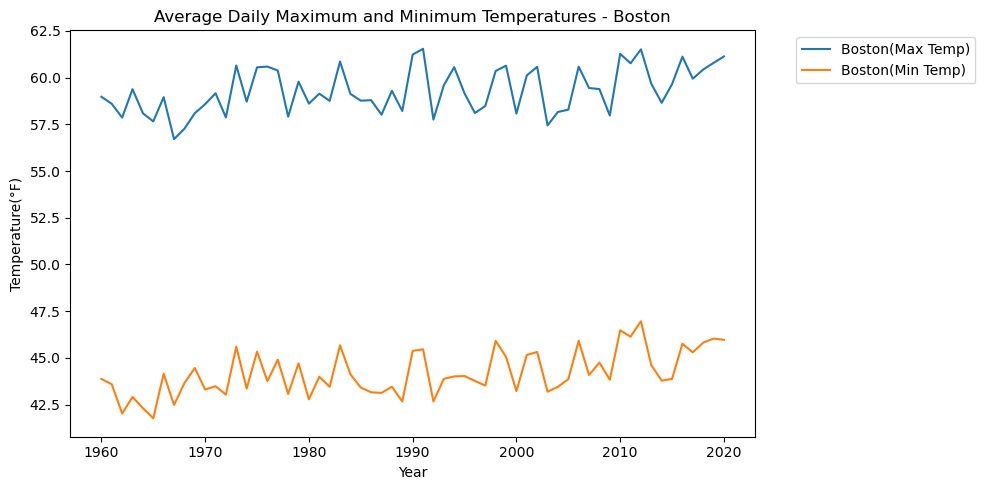

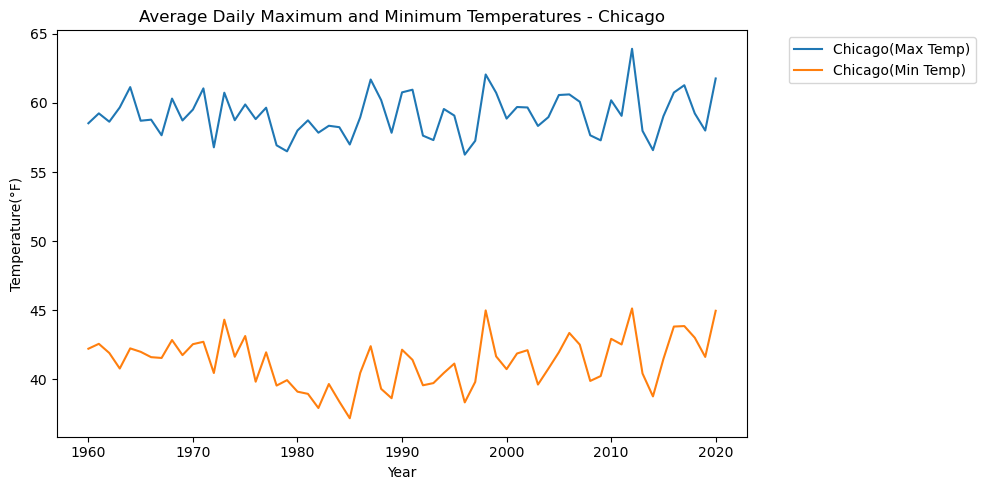

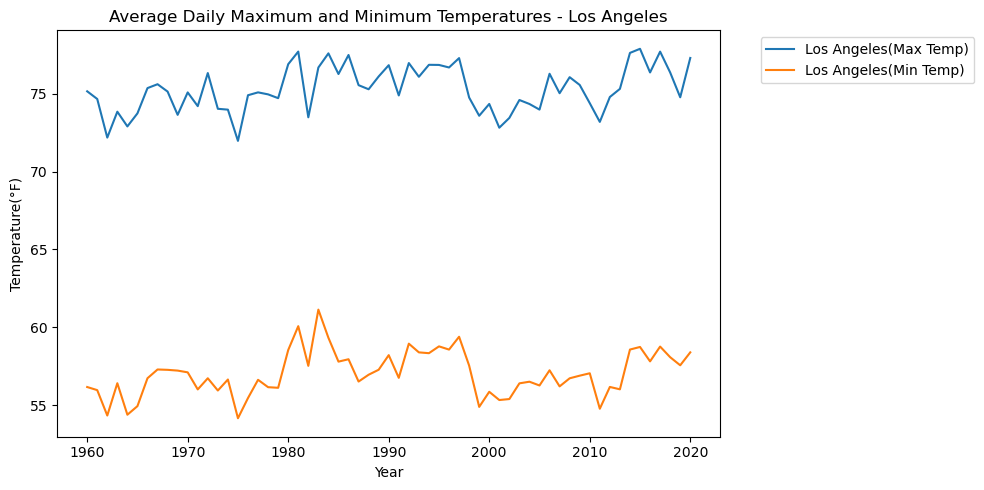

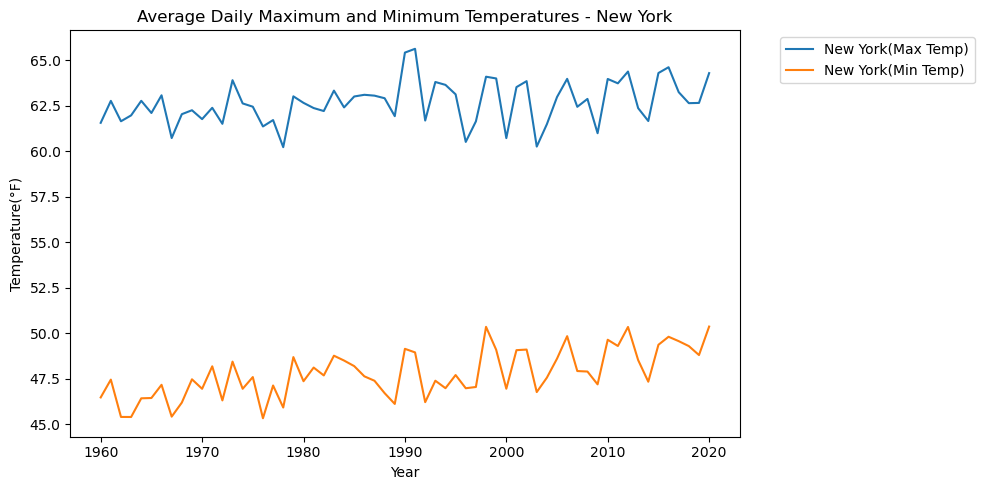

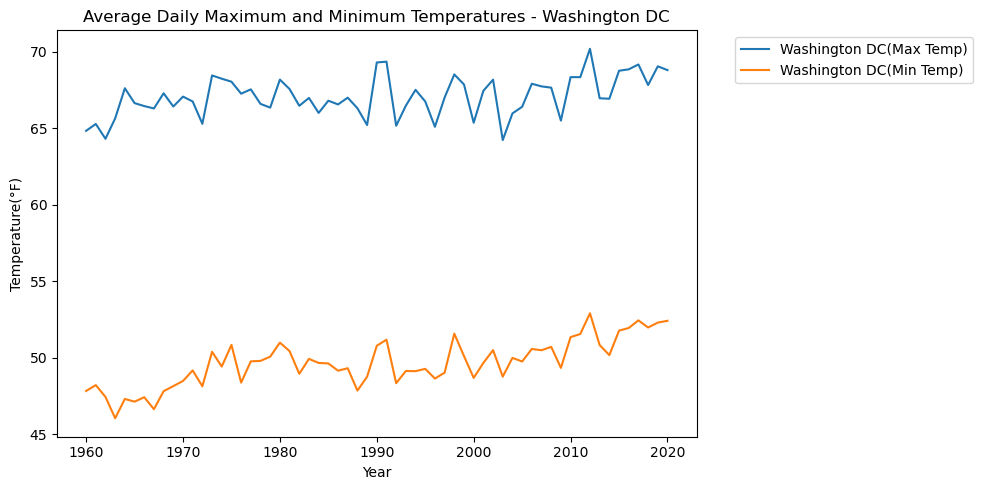

In [9]:
# Iterate over each city
for city in cities:
    # Create a figure and axis object for each city
    fig, ax = plt.subplots(figsize=(10,5))

    # Filter the data for the current city
    city_data = df[df['City'] == city]

    # Calculate the average maximum and minimum tempratures for each year
    avg_max_temps = city_data.groupby(df['Year'])['tmax'].mean()
    avg_min_temps = city_data.groupby(df['Year'])['tmin'].mean()

    # Plot the average maximum and minimum temperature as lines
    ax.plot(avg_max_temps.index, avg_max_temps, label=f'{city}(Max Temp)')
    ax.plot(avg_min_temps.index, avg_min_temps, label=f'{city}(Min Temp)')

    # Set the labels and title for the graph
    ax.set_xlabel('Year')
    ax.set_ylabel('Temperature(°F)')
    ax.set_title(f'Average Daily Maximum and Minimum Temperatures - {city}')

    # Move the legend outside the graph and prevent it from overlapping
    ax.legend(bbox_to_anchor=(1.05,1), loc='upper left')

    # Adjust the layout to make room for the legend
    fig.tight_layout()

    # Show the graph
    plt.show()

## Plot Monthly Average Temperatures by Decades

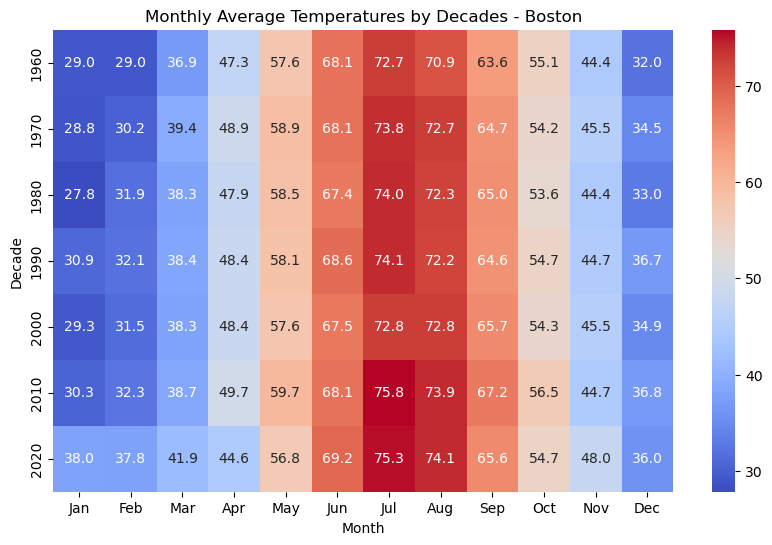

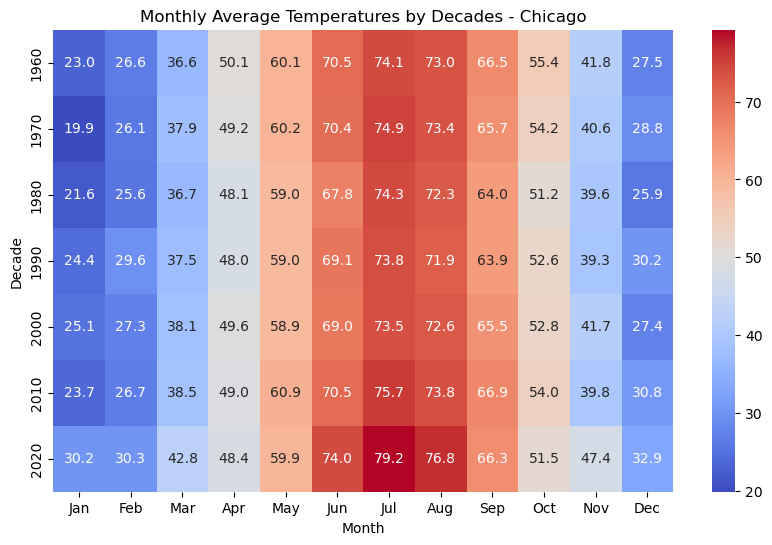

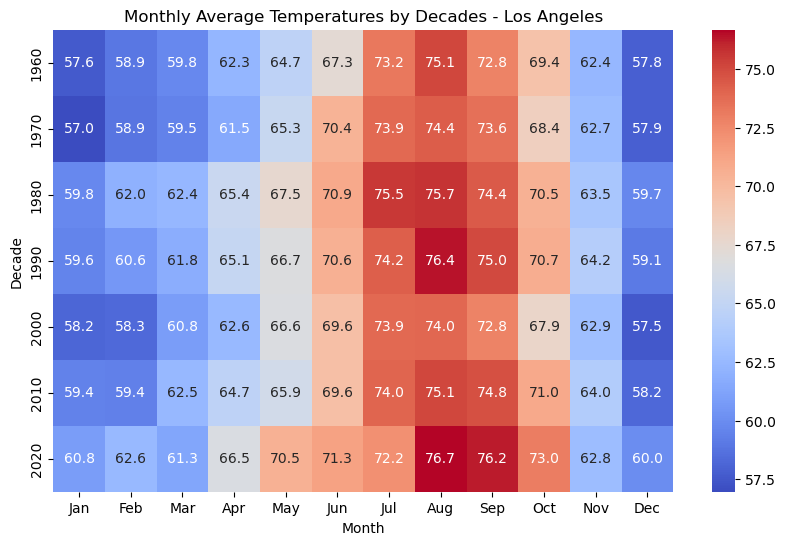

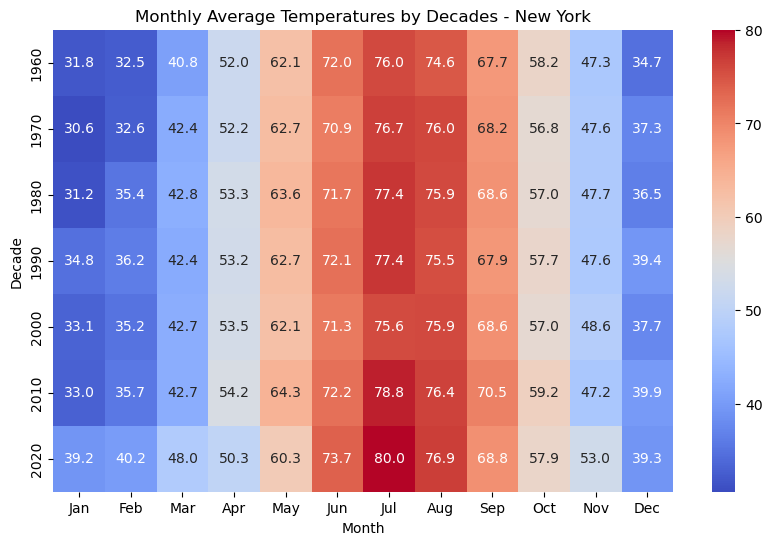

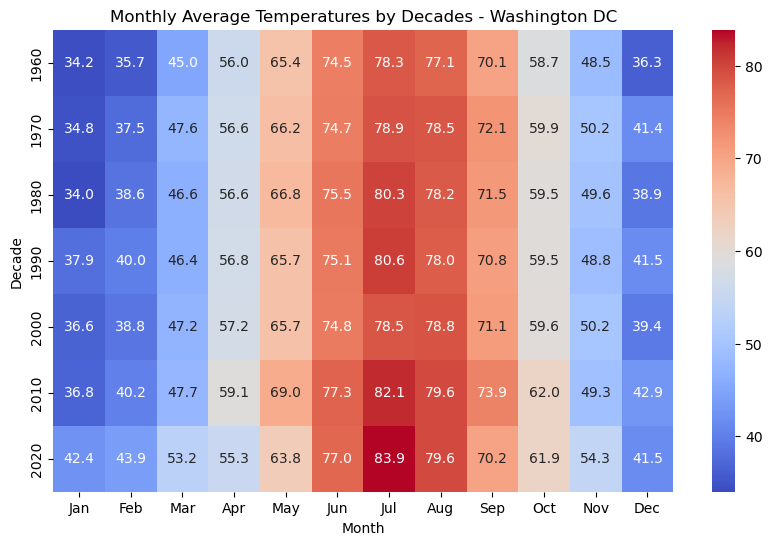

In [10]:
# Define the decades
decades = range(df['Year'].min() // 10 * 10, df['Year'].max() // 10 * 10 + 1, 10)

# Define the order of months starting from January
month_order = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

# Iterate over each city
for city in cities:
    # Filter the data for the current city
    city_data = df[df['City'] == city].copy()  # Make a copy of the filtered DataFrame

    # Group by decade and month, and calculate the average temperature
    city_data['Decade'] = city_data['Year'] // 10 * 10
    avg_by_decade = city_data.groupby(['Decade', 'Month']).mean(numeric_only=True).reset_index()

    # Pivot the table to reshape the data
    pivot_table = avg_by_decade.pivot(index='Decade', columns='Month', values='tavg')

    # Rearrange the columns
    pivot_table = pivot_table[month_order]

    # Set the size of the heatmap
    plt.figure(figsize=(10, 6))

    # Create the heatmap
    sns.heatmap(pivot_table, cmap='coolwarm', annot=True, fmt=".1f", cbar=True)

    # Set the title and labels
    plt.title(f"Monthly Average Temperatures by Decades - {city}")
    plt.xlabel("Month")
    plt.ylabel("Decade")

    # Show the heatmap
    plt.show()

## Plot Average Yearly Precipitation by Cities

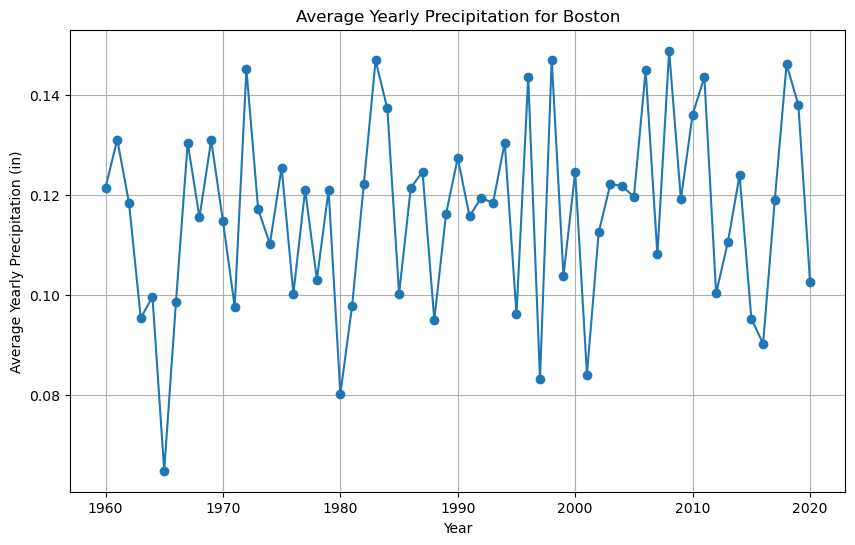

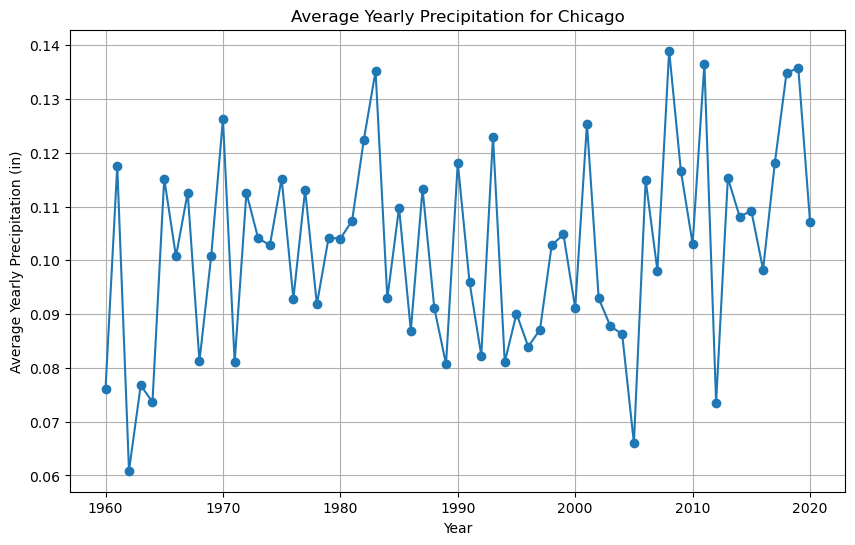

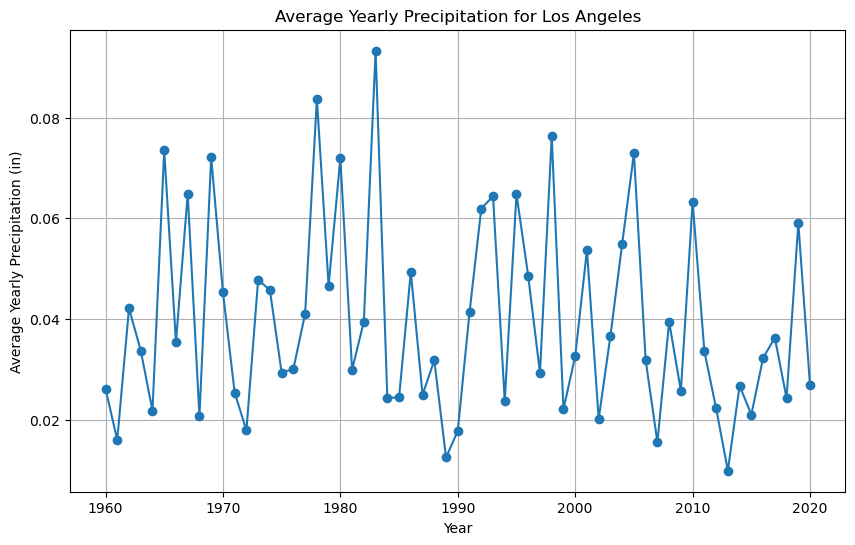

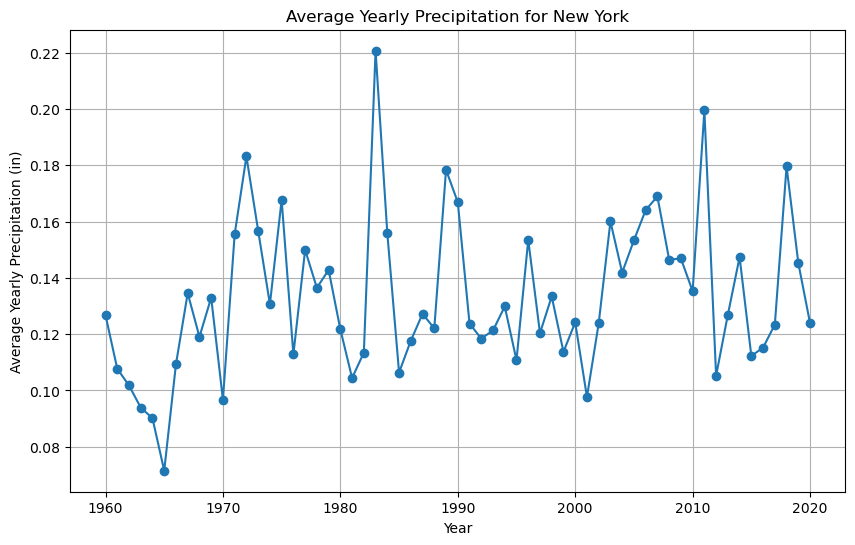

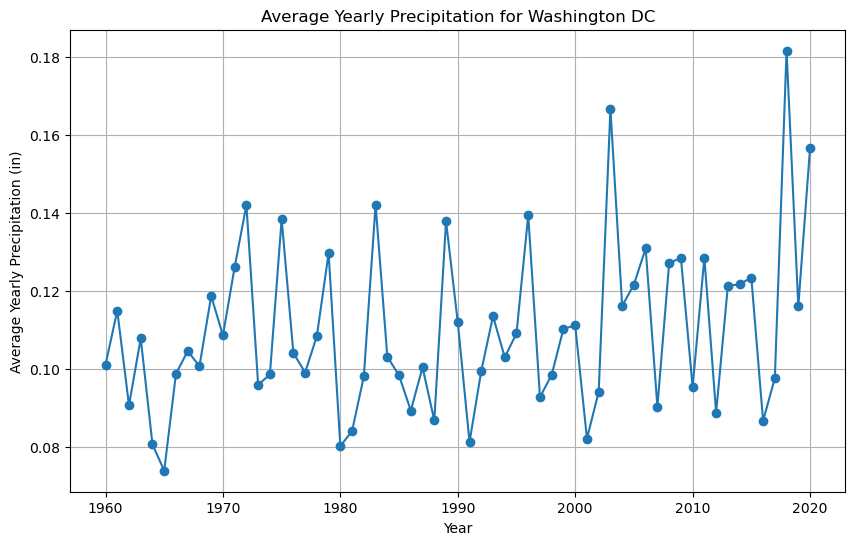

In [11]:
# Group the data by 'City' and 'Year' and calculate the average precipitation for each city and year
average_precipitation = df.groupby(['City', 'Year'])['prcp'].mean()

# Iterate over each city and create a separate plot for each
for city in cities:
    # Filter the data for the current city
    city_data = average_precipitation[city]

    # Create a list of years for the x-axis
    years = city_data.index.tolist()

    # Create a list of average precipitation values for the y-axis
    averages = city_data.tolist()

    # Set the graph size
    plt.figure(figsize=(10, 6))

    # Plot the average yearly precipitation for the current city
    plt.plot(years, averages, marker='o')

    # Set the x-axis label, y-axis label, and plot title
    plt.xlabel('Year')
    plt.ylabel('Average Yearly Precipitation (in)')
    plt.title(f'Average Yearly Precipitation for {city}')

    # Display the plot
    plt.grid(True)
    plt.show()

## Plot Temperature and Moving Average by Cities

In [12]:
# Set the rolling window size for the moving average
rolling_window_size = 30

# Create a separate plot for each city
for city in cities:
    # Filter the data for the specific city
    city_data = df[df["City"] == city].copy()

    # Calculate the moving average of the 'tavg' column
    city_data['tavg_ma'] = city_data['tavg'].rolling(rolling_window_size).mean()

    # Create a plotly figure
    fig = go.Figure()

    # Add traces for the original temperature data and moving average
    fig.add_trace(go.Scatter(x=city_data['Date'], y=city_data['tavg'], mode='lines', name='Original Temperature'))
    fig.add_trace(go.Scatter(x=city_data['Date'], y=city_data['tavg_ma'], mode='lines', name='Moving Average'))

    # Configure the layout
    fig.update_layout(
        title=f'Temperature Data and Moving Average for {city}',
        xaxis_title='Date',
        yaxis_title='Temperature (°F)',
        hovermode='x',
        legend=dict(x=0.7, y=0.9),
        template='plotly_white'
    )

    # Show the interactive plot
    fig.show()

## Select and Rename Relevant Columns

In [13]:
# Select the relevant columns
df = pd.DataFrame(df, columns=['Date', 'tavg', 'City'])

# Rename the columns
city_data = df[df['City'] == city].copy()
df.rename(columns={"Date": "ds", "tavg": "y"}, inplace=True)

## Generate Weather Forecasts for Next Five Years

12:03:42 - cmdstanpy - INFO - Chain [1] start processing
12:03:57 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1000x600 with 0 Axes>

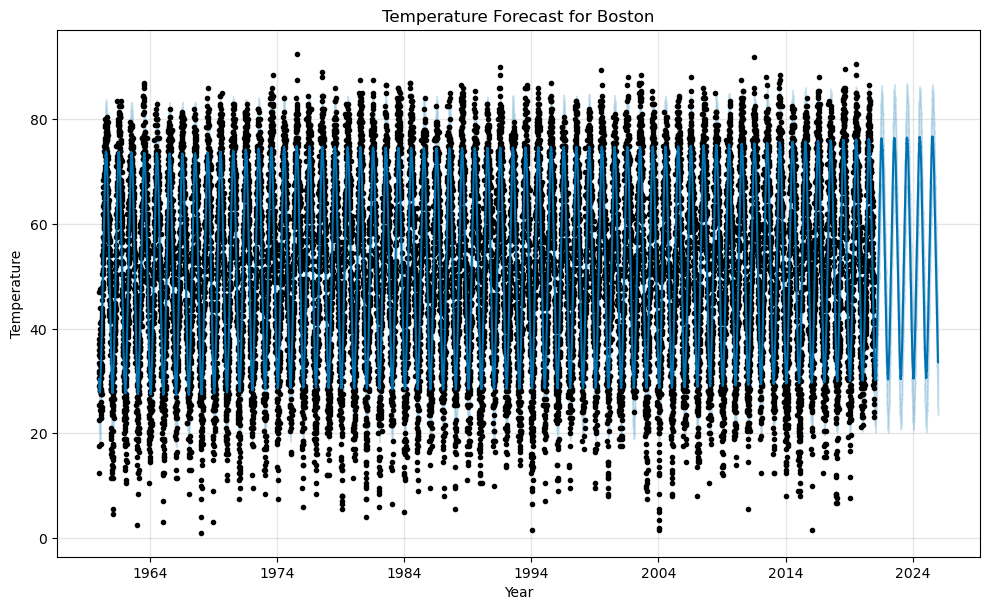

12:04:31 - cmdstanpy - INFO - Chain [1] start processing
12:04:38 - cmdstanpy - INFO - Chain [1] done processing


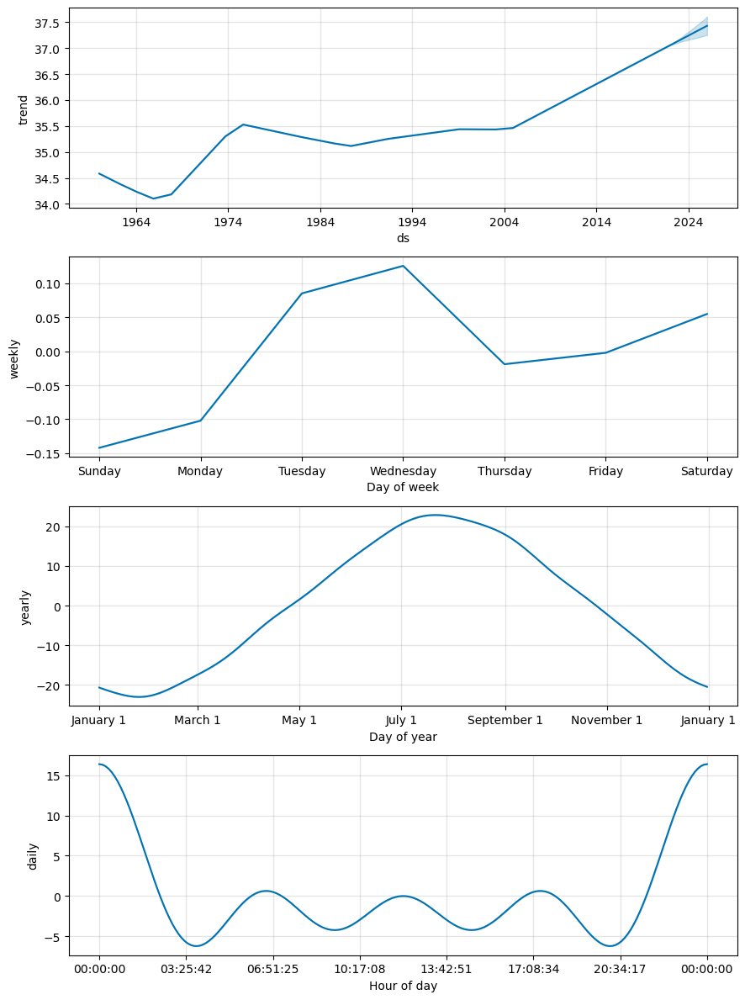

<Figure size 1000x600 with 0 Axes>

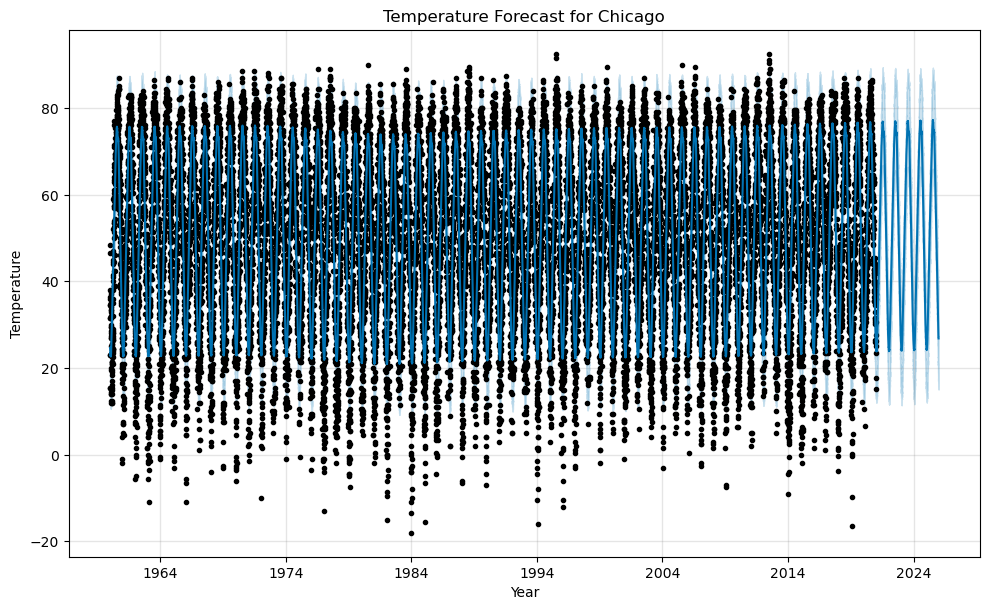

12:05:02 - cmdstanpy - INFO - Chain [1] start processing
12:05:19 - cmdstanpy - INFO - Chain [1] done processing


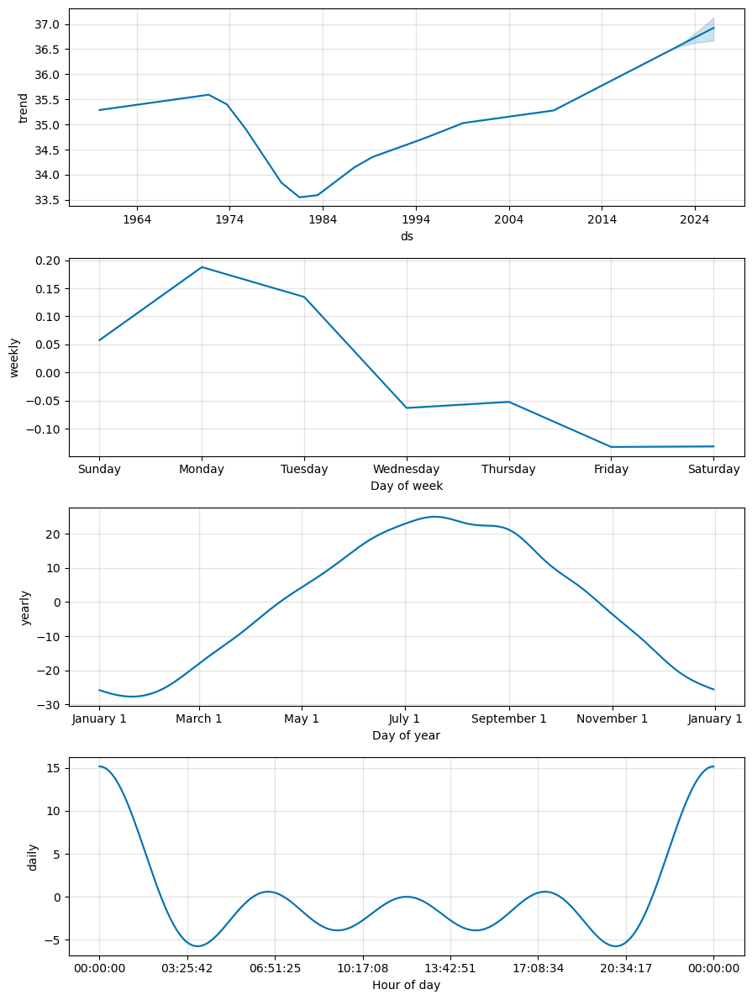

<Figure size 1000x600 with 0 Axes>

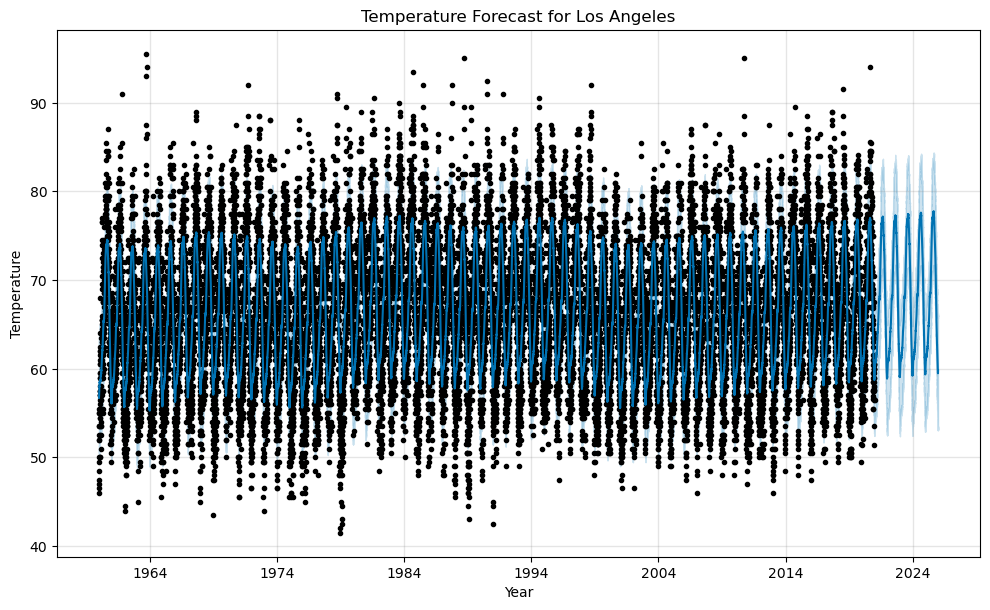

12:05:48 - cmdstanpy - INFO - Chain [1] start processing
12:05:56 - cmdstanpy - INFO - Chain [1] done processing


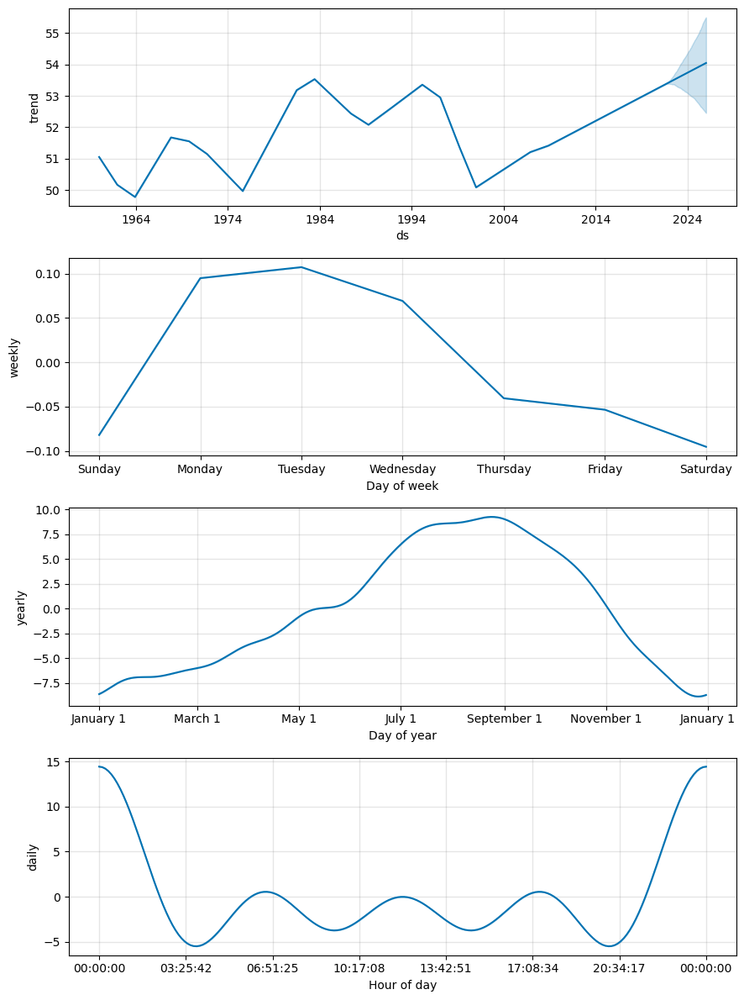

<Figure size 1000x600 with 0 Axes>

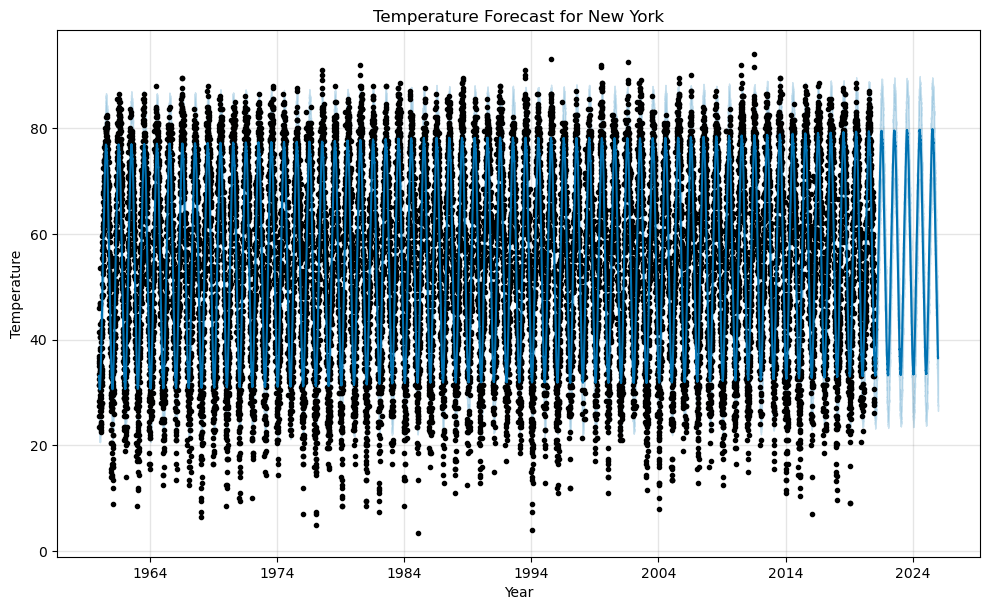

12:06:21 - cmdstanpy - INFO - Chain [1] start processing
12:06:31 - cmdstanpy - INFO - Chain [1] done processing


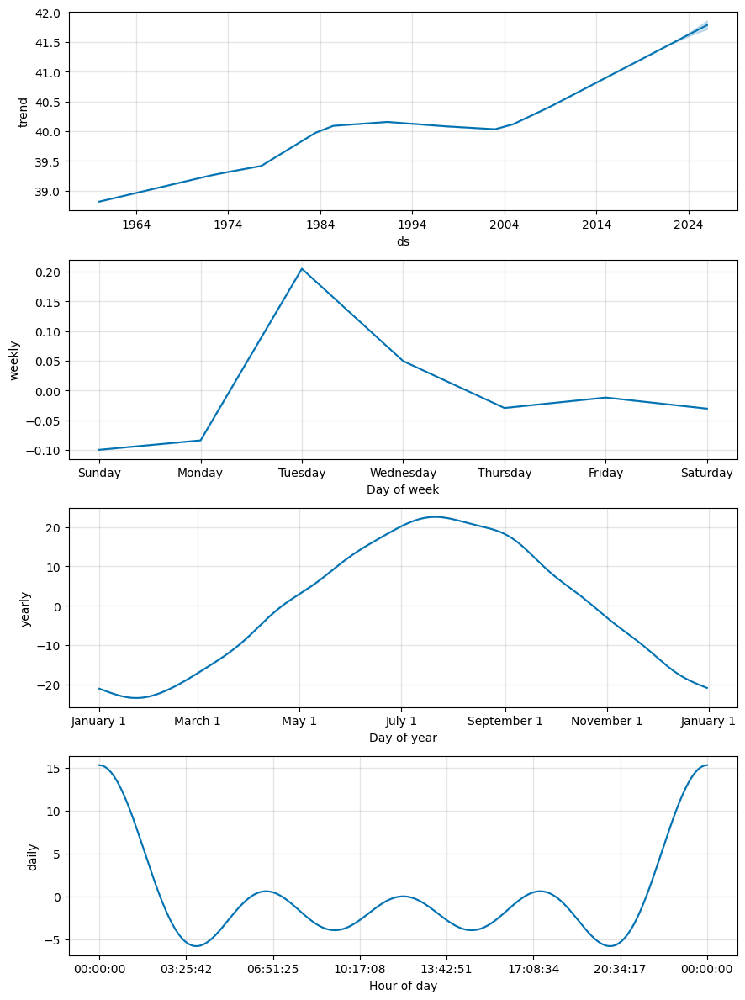

<Figure size 1000x600 with 0 Axes>

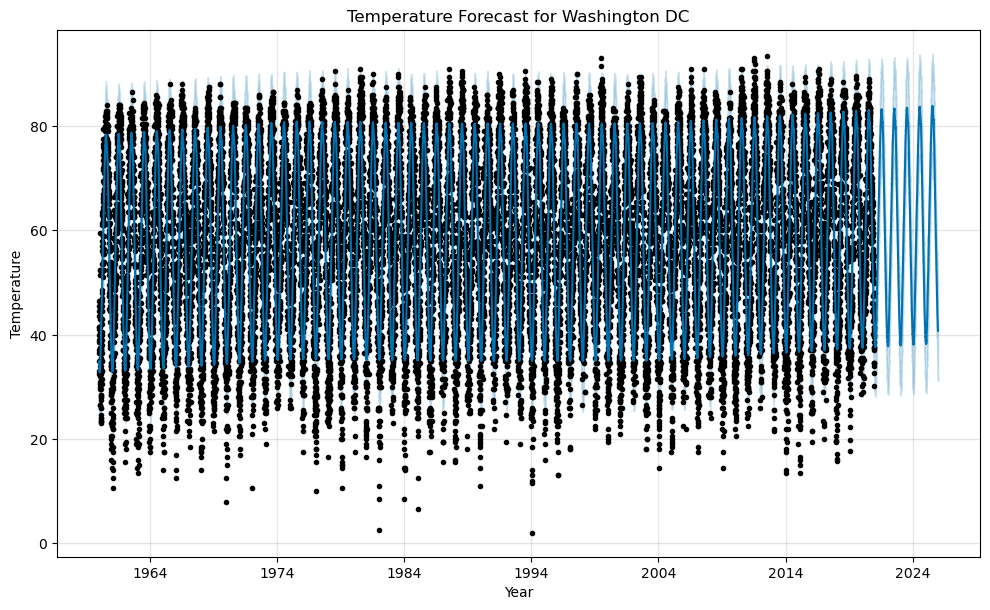

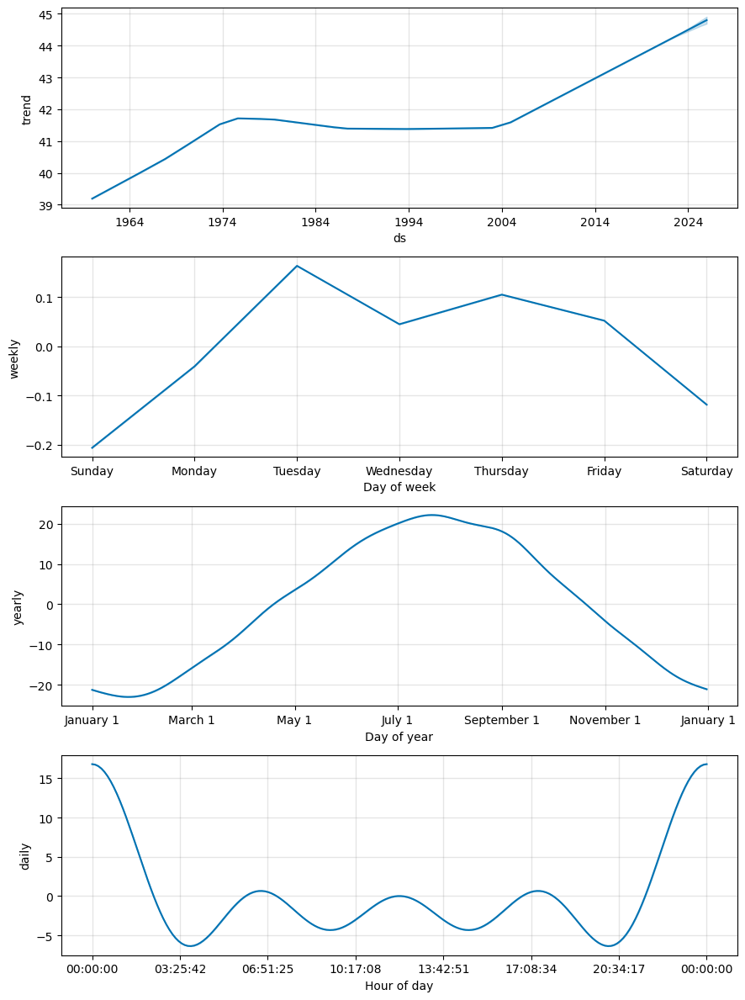

In [14]:
# Iterate over each city and create a separate graph for each
for city in cities:
    # Filter the data for the current city
    city_data = df[df['City'] == city]

    # Create a Prophet model
    model = Prophet(daily_seasonality=True)

    # Fit the model with the city-specific data
    model.fit(city_data)

    # Generate future dates for prediction (next five years)
    future_dates = model.make_future_dataframe(periods=365*5)

    # Make predictions for the future dates
    forecast = model.predict(future_dates)

    # Set the graph size
    plt.figure(figsize=(10, 6))

    # Plot the overall trend
    model.plot(forecast, xlabel='Year', ylabel='Temperature')

    # Set the plot title
    plt.title(f'Temperature Forecast for {city}')

    # Display the plot
    plt.show()

    # Plot the components: trend, yearly seasonality, and weekly seasonality
    fig = model.plot_components(forecast)

## Conclusion

The analysis reveals a gradual rise in average temperatures across all cities from 1960 to 2020. Seasonal variations are consistent, with significant summer peaks and winter troughs. Precipitation patterns remain relatively stable but vary by geography.

## Forecast
Using Prophet, we forecasted average daily temperatures for the next 5 years. The projections continue the warming trend, which is in line with global climate change patterns.

## Recommendations
- Conduct policy-level environmental planning for urban heat mitigation.
- Expand the dataset with humidity, wind speed, and air quality indexes.
- Consider integrating real-time APIs (e.g., NOAA, OpenWeather) for live monitoring.